In [1]:
import numpy as np
import os
from tqdm import trange

In [2]:
# def sample_simple_ic(X, Y, max_modes=45):
#     """
#     Build a sum of up to max_modes low-frequency sine modes.
#     Returns f0(X,Y) and g0(X,Y)=0.
#     """
#     f0 = np.zeros_like(X)
#     M  = np.random.randint(45, max_modes+1)
#     for _ in range(M):
#         kx  = np.random.randint(1, 4)
#         ky  = np.random.randint(1, 4)
#         A   = np.random.uniform(0.5, 1.0)
#         phi = np.random.uniform(0, 2*np.pi)
#         f0 += A * np.sin(2*np.pi*(kx*X + ky*Y)) + phi
#     g0 = np.zeros_like(X)
#     return f0, g0

In [3]:
def sample_simple_ic(X, Y, k_max=7, M=10, p=2.0, seed=None):
    """
    Sum of M random sine modes whose amplitude decays like |k|^{-p}.
    Both displacement f0 and velocity g0 are returned.
    """
    if seed is not None:
        np.random.seed(seed)

    f0 = np.zeros_like(X)
    g0 = np.zeros_like(X)
    for _ in range(M):
        kx = np.random.randint(1, k_max+1)
        ky = np.random.randint(1, k_max+1)
        k  = np.sqrt(kx**2 + ky**2)
        A  = np.random.uniform(0.5, 1.0) * k**(-p)  
        phi_f = np.random.uniform(0, 2*np.pi)
        phi_g = np.random.uniform(0, 2*np.pi)

        f0 += A * np.sin(2*np.pi*(kx*X + ky*Y) + phi_f)
        g0 += A * np.sin(2*np.pi*(kx*X + ky*Y) + phi_g)  
    return f0, g0

In [4]:
def generate_wave_dataset(
    N_samples=20,
    Lx=1.0, Ly=1.0,
    Nx=128, Ny=128,
    c=0.5,
    dt=0.01,
    t_final=10.0,
    downsample_factors=(2, 4, 8),
    output_dir="/pscratch/sd/h/hbassi/wave_dataset",
):
    """
    Generate N_samples of 2D wave data with periodic BCs.
    For each downsample factor in downsample_factors, evolve
    on its own coarse grid, then per-sample min–max normalize
    all trajectories by the fine-grid extrema and save to disk.
    """
    from tqdm import trange

    Nt = int(np.round(t_final/dt)) + 2
    c2dt2 = (c*dt)**2

    # build fine grid
    x   = np.linspace(0, Lx, Nx, endpoint=False)
    y   = np.linspace(0, Ly, Ny, endpoint=False)
    Xf, Yf = np.meshgrid(x, y, indexing='ij')

    # prepare storage
    u_fine = np.zeros((N_samples, Nt, Nx, Ny), dtype=np.float32)
    # one array per factor:
    u_coarse = {
        r: np.zeros((N_samples, Nt, Nx//r, Ny//r), dtype=np.float32)
        for r in downsample_factors
    }

    # CFL check for each grid
    for r in downsample_factors:
        dx_c = Lx/(Nx//r)
        dy_c = Ly/(Ny//r)
        sigma = c*dt*np.sqrt(1/dx_c**2 + 1/dy_c**2)
        if sigma >= 1:
            raise ValueError(f"CFL violation at r={r}: σ={sigma:.3f}")

    for s in trange(N_samples, desc="Generating samples"):
        # temporary raw trajectories
        raw_fine = np.zeros((Nt, Nx, Ny), dtype=np.float32)
        raw_coarse = {
            r: np.zeros((Nt, Nx//r, Ny//r), dtype=np.float32)
            for r in downsample_factors
        }

        # initial condition on fine
        f0_f, g0_f = sample_simple_ic(Xf, Yf)

        # precompute fine u at t=0,1
        lap0_f = (
            (np.roll(f0_f, +1, 0) + np.roll(f0_f, -1, 0) - 2*f0_f)/(Lx/Nx)**2
          + (np.roll(f0_f, +1, 1) + np.roll(f0_f, -1, 1) - 2*f0_f)/(Ly/Ny)**2
        )
        u_nm1_f = f0_f.copy()
        u_n_f   = u_nm1_f + dt*g0_f + 0.5*c2dt2*lap0_f

        raw_fine[0] = u_nm1_f
        raw_fine[1] = u_n_f

        # initialize each coarse grid
        coarse_states = {}
        for r in downsample_factors:
            # downsample ICs
            f0_c = f0_f[::r, ::r]
            g0_c = np.zeros_like(f0_c)
            dx_c, dy_c = Lx/(Nx//r), Ly/(Ny//r)

            lap0_c = (
                (np.roll(f0_c, +1, 0) + np.roll(f0_c, -1, 0) - 2*f0_c)/dx_c**2
              + (np.roll(f0_c, +1, 1) + np.roll(f0_c, -1, 1) - 2*f0_c)/dy_c**2
            )
            u_nm1_c = f0_c.copy()
            u_n_c   = u_nm1_c + dt*g0_c + 0.5*c2dt2*lap0_c

            raw_coarse[r][0] = u_nm1_c
            raw_coarse[r][1] = u_n_c
            coarse_states[r] = (u_nm1_c, u_n_c, dx_c, dy_c)

        # time march
        for n in range(1, Nt-1):
            # fine step
            lap_f = (
                (np.roll(u_n_f, +1, 0) + np.roll(u_n_f, -1, 0) - 2*u_n_f)/(Lx/Nx)**2
              + (np.roll(u_n_f, +1, 1) + np.roll(u_n_f, -1, 1) - 2*u_n_f)/(Ly/Ny)**2
            )
            u_np1_f = 2*u_n_f - u_nm1_f + c2dt2*lap_f
            u_nm1_f, u_n_f = u_n_f, u_np1_f
            raw_fine[n+1] = u_n_f

            # coarse steps
            for r in downsample_factors:
                u_nm1_c, u_n_c, dx_c, dy_c = coarse_states[r]
                lap_c = (
                    (np.roll(u_n_c, +1, 0) + np.roll(u_n_c, -1, 0) - 2*u_n_c)/dx_c**2
                  + (np.roll(u_n_c, +1, 1) + np.roll(u_n_c, -1, 1) - 2*u_n_c)/dy_c**2
                )
                u_np1_c = 2*u_n_c - u_nm1_c + c2dt2*lap_c
                coarse_states[r] = (u_n_c, u_np1_c, dx_c, dy_c)
                raw_coarse[r][n+1] = u_np1_c

        # normalize per-sample by fine extrema
        u_min, u_max = raw_fine.min(), raw_fine.max()
        if u_max > u_min:
            norm_fine = (raw_fine - u_min)/(u_max - u_min)
            for r in downsample_factors:
                u_coarse[r][s] = (raw_coarse[r] - u_min)/(u_max - u_min)
        else:
            norm_fine = np.zeros_like(raw_fine)
            for r in downsample_factors:
                u_coarse[r][s] = np.zeros_like(raw_coarse[r])

        u_fine[s] = norm_fine

    # save
    os.makedirs(output_dir, exist_ok=True)
    np.save(os.path.join(output_dir, "u_fine_test.npy"), u_fine)
    for r in downsample_factors:
        fname = f"u_coarse_sf={r}_test.npy"
        np.save(os.path.join(output_dir, fname), u_coarse[r])

    print(f"Saved fine and coarse datasets for factors {downsample_factors} to {output_dir!r}")

In [5]:
generate_wave_dataset(
    N_samples=20,
    Nx=128, Ny=128,
    downsample_factors=[2,4,8],
    output_dir="/pscratch/sd/h/hbassi/wave_dataset_multi_sf_modes=10_kmax=7/"
)


Generating samples: 100%|██████████| 20/20 [00:09<00:00,  2.21it/s]


Saved fine and coarse datasets for factors [2, 4, 8] to '/pscratch/sd/h/hbassi/wave_dataset_multi_sf_modes=10_kmax=7/'


In [15]:
# u_c = np.load('/pscratch/sd/h/hbassi/wave_dataset/u_coarse_low_freq_sf=8.npy')
# u_f = np.load('/pscratch/sd/h/hbassi/wave_dataset/u_fine_low_freq_sf=8.npy')
# u_c.shape, u_f.shape

In [2]:
import matplotlib.pyplot as plt

# --- Load your saved datasets ---
u_f = np.load("/pscratch/sd/h/hbassi/wave_dataset_multi_sf_modes=10_kmax=7/u_fine_test.npy")
downsample_factors = [2, 4, 8]
u_c = {
    r: np.load(f"/pscratch/sd/h/hbassi/wave_dataset_multi_sf_modes=10_kmax=7/u_coarse_sf={r}_test.npy")
    for r in downsample_factors
}

In [3]:
[u_c[r].shape for r in list(u_c.keys()) ], u_f.shape

([(20, 1002, 64, 64), (20, 1002, 32, 32), (20, 1002, 16, 16)],
 (20, 1002, 128, 128))

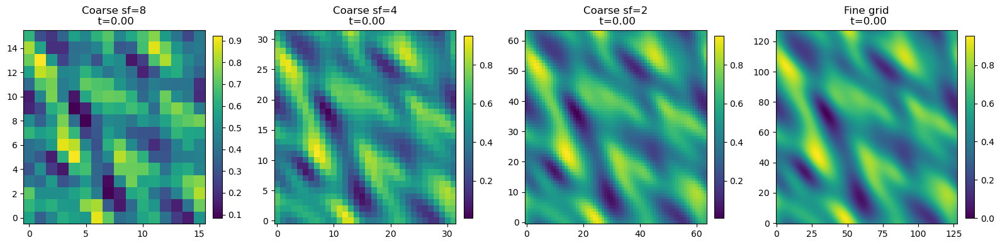

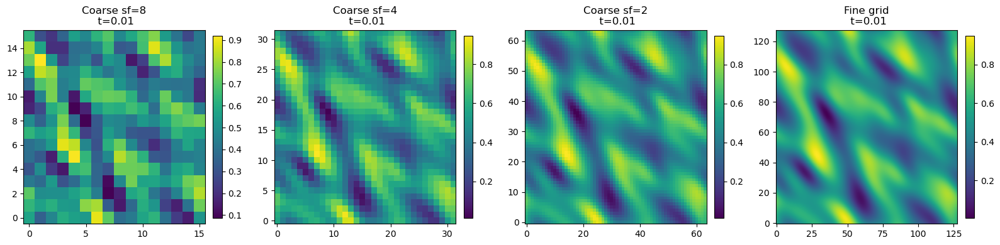

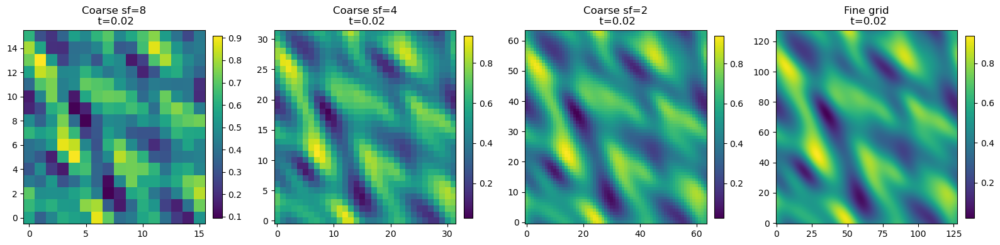

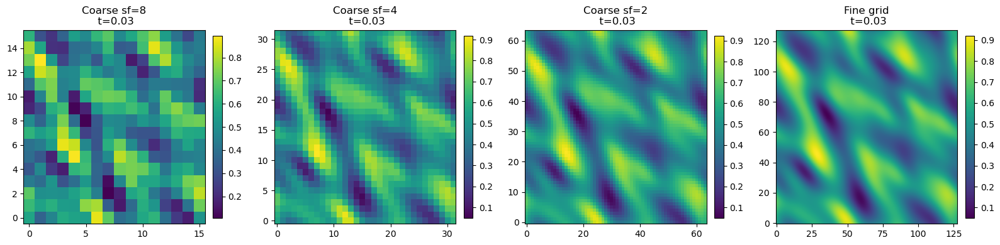

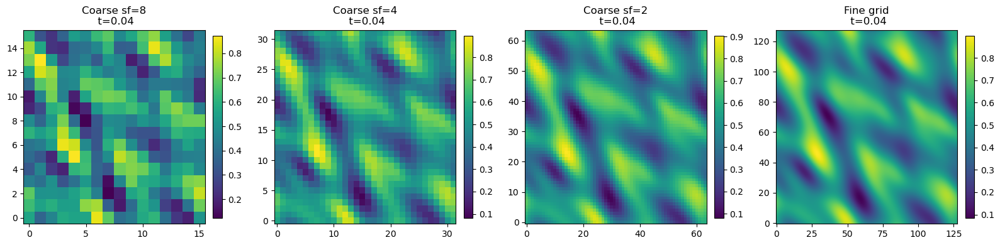

...

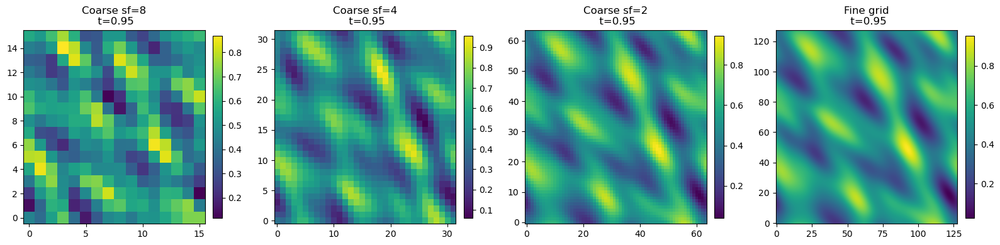

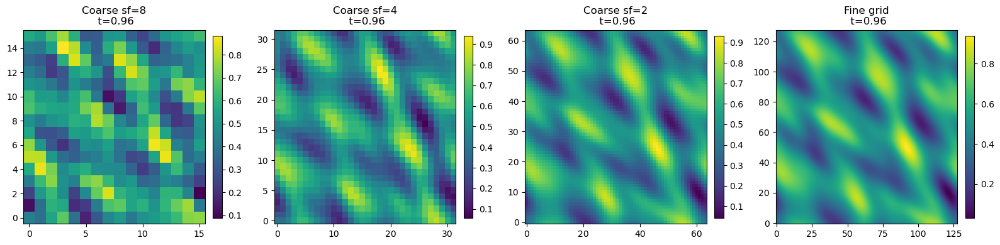

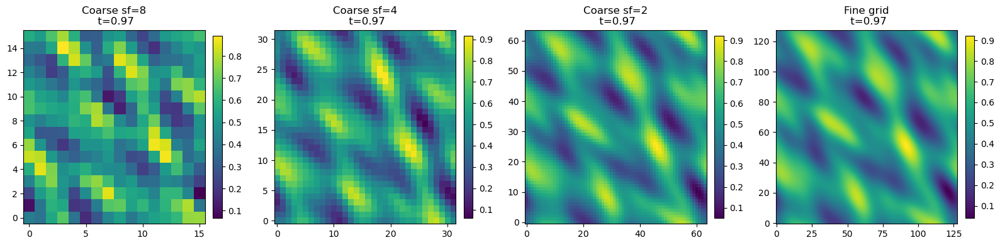

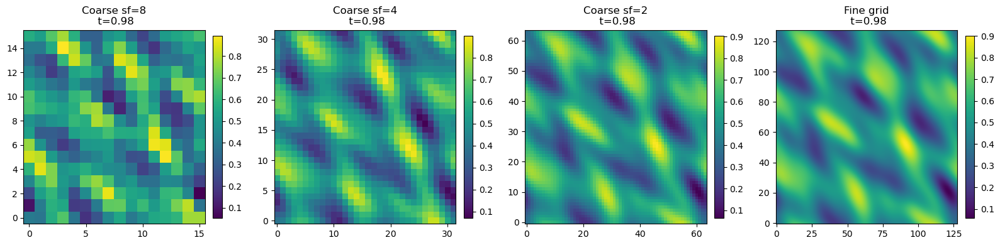

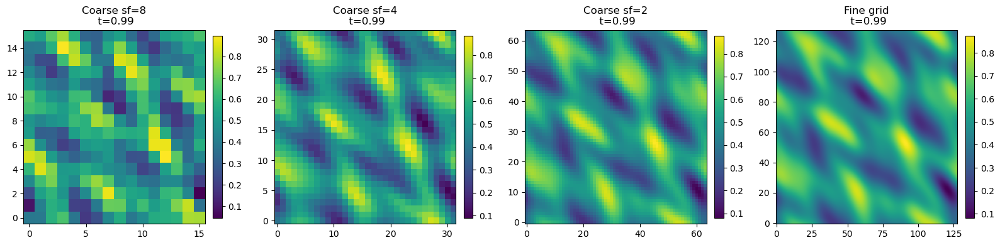

In [6]:
# --- Parameters ---
sample_idx   = 2
dt            = 0.01
time_indices = list(range(0, 100, 1))
factors_sorted = sorted(downsample_factors, reverse=True)

# --- Loop over times, plot 1×4 figures ---
for t in time_indices:
    fig, axes = plt.subplots(1, len(factors_sorted) + 1,
                             figsize=(4 * (len(factors_sorted) + 1), 4))
    
    # plot each coarse level
    for i, r in enumerate(factors_sorted):
        ax = axes[i]
        im = ax.imshow(u_c[r][sample_idx, t], origin='lower', aspect='auto')
        ax.set_title(f"Coarse sf={r}\n t={t*dt:.2f}")
        fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    
    # plot the fine grid last
    ax_fine = axes[-1]
    imf = ax_fine.imshow(u_f[sample_idx, t], origin='lower', aspect='auto')
    ax_fine.set_title(f"Fine grid\n t={t*dt:.2f}")
    fig.colorbar(imf, ax=ax_fine, fraction=0.046, pad=0.04)
    
    plt.tight_layout()
    plt.show()

In [7]:
def radial_energy_spectrum(u):
    """
    Return one-sided radial spectrum normalized so that
    sum_k E(k) == sum_x,y |u|^2  (Parseval).
    """
    N = u.shape[0]
    u_hat = np.fft.fftshift(np.fft.fft2(u))
    energy_density = np.abs(u_hat)**2 / N ** 2
    kx = np.fft.fftshift(np.fft.fftfreq(N))*N
    KX, KY = np.meshgrid(kx, kx, indexing='ij')
    kr     = np.sqrt(KX**2 + KY**2).astype(int)
    E      = np.bincount(kr.ravel(), energy_density.ravel(),
                         minlength=kr.max()+1)
    return np.arange(kr.max()+1), E


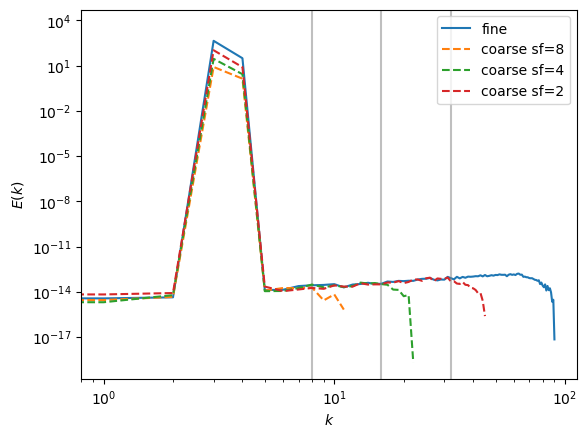

In [8]:
k_fine, E_fine = radial_energy_spectrum(u_f[sample_idx,t])
plt.loglog(k_fine, E_fine, label='fine')
nyqs = {}
for r in factors_sorted:
    k_coarse, E_coarse = radial_energy_spectrum(u_c[r][sample_idx,t])
    plt.loglog(k_coarse, E_coarse, '--', label=f'coarse sf={r}')
    k_nyq = (u_c[r].shape[-1]//2)  # integer Nyquist index
    nyqs[r]= k_nyq
    plt.axvline(k_nyq, color='grey', alpha=0.5)

plt.xlabel(r'$k$'); plt.ylabel(r'$E(k)$'); plt.legend(); plt.show()

In [11]:
def alias_metrics(u_fine, u_coarse, r):
    _, E_fine   = radial_energy_spectrum(u_fine)
    _, E_coarse = radial_energy_spectrum(u_coarse)

    Nfine = u_fine.shape[-1]
    k_nyq = (Nfine // r) // 2

    Ef_tot   = E_fine.sum()
    Ef_keep  = E_fine[:k_nyq+1].sum()
    Ec_tot   = E_coarse.sum()

    eta_r   = 1.0 - Ef_keep/Ef_tot
    delta_r = (Ec_tot - Ef_keep)/Ef_tot
    return eta_r, delta_r


In [12]:
# ---------- example ----------
sample_idx = 6
t          = 100     # pick your snapshot

fine_snap  = u_f[sample_idx, t]
for r in downsample_factors:
    coarse_snap = u_c[r][sample_idx, t]
    delta_r, A_r = alias_metrics(fine_snap, coarse_snap, r)
    print(f"sf={r}: alias offset δ_r = {delta_r:+.3%}")

sf=2: alias offset δ_r = +0.000%
sf=4: alias offset δ_r = +0.000%
sf=8: alias offset δ_r = +0.016%


In [13]:
def lost_energy_ratio(u_fine, u_coarse_dict):
    """
    Return dict {r: (eta_r, delta_r)} for one snapshot.
    """
    _, E_fine = radial_energy_spectrum(u_fine)
    E_fine_tot = E_fine.sum()
    results = {}

    Nfine = u_fine.shape[-1]

    for r, u_c in u_coarse_dict.items():
        _, Ecoarse = radial_energy_spectrum(u_c)
        Ecoarse_tot = Ecoarse.sum()

        k_nyq = (Nfine // r) // 2          # Nyquist index of coarse grid
        E_fine_below = E_fine[:k_nyq+1].sum()

        eta_r   = (E_fine_tot - E_fine_below) / E_fine_tot      # truncation loss
        delta_r = (Ecoarse_tot - E_fine_below) / E_fine_tot     # aliasing offset
        results[r] = (eta_r, delta_r)
    return results

In [14]:
all_eta = {r: [] for r in downsample_factors}
for t in range(u_f.shape[1]):
    fine = u_f[sample_idx, t]
    coarse = {r: u_c[r][sample_idx, t] for r in downsample_factors}
    for r, (eta, _) in lost_energy_ratio(fine, coarse).items():
        all_eta[r].append(eta)
print({r: np.mean(all_eta[r]) for r in all_eta})  # time-averaged loss

{2: 9.68097157903256e-16, 4: 1.1557256697446131e-15, 8: 0.0001911189471080166}


In [15]:
def alias_metrics(u_fine, u_coarse, r):
    _, E_fine   = radial_energy_spectrum(u_fine)
    _, E_coarse = radial_energy_spectrum(u_coarse)

    Nfine  = u_fine.shape[-1]
    k_nyq  = (Nfine // r) // 2              # Nyquist index on coarse grid

    E_fine_below = E_fine[:k_nyq+1].sum()
    E_coarse_tot = E_coarse.sum()           # Parseval on coarse grid

    delta_r = (E_coarse_tot - E_fine_below) / E_fine.sum()
    A_r     = E_coarse[:k_nyq+1] - E_fine[:k_nyq+1]

    return delta_r, A_r

sf=2: alias offset δ_r = -75.123%
sf=4: alias offset δ_r = -93.776%
sf=8: alias offset δ_r = -98.421%


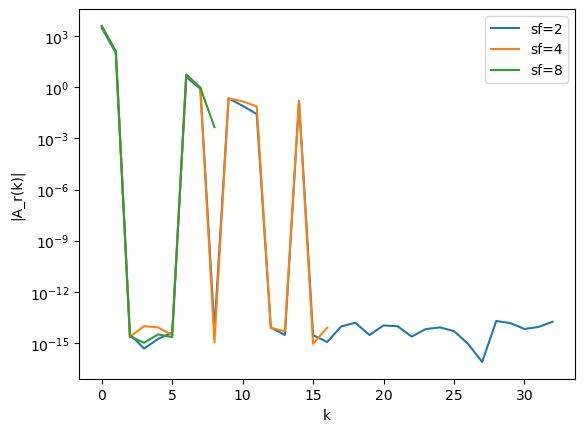

In [16]:
# ---------- example ----------
sample_idx = 6
t          = 100     

fine_snap  = u_f[sample_idx, t]
for r in downsample_factors:
    coarse_snap = u_c[r][sample_idx, t]
    delta_r, A_r = alias_metrics(fine_snap, coarse_snap, r)
    print(f"sf={r}: alias offset δ_r = {delta_r:+.3%}")

    # OPTIONAL: plot per-shell alias map
    k = np.arange(len(A_r))
    plt.semilogy(k, np.abs(A_r)+1e-20, label=f'sf={r}')
plt.xlabel('k'); plt.ylabel('|A_r(k)|'); plt.legend(); plt.show()